# Moran's autocorrelation coefficient on Saliency map of images

The idea of this notebook is to compute the saliency of the image via an algorithm and then to check whether saliency peaks are spatially clustered or rather dispersed. This latter point is analysed via a Moran's I autocorrelation https://en.wikipedia.org/wiki/Moran%27s_I
Moran's autocorrelation can thus be assumed as an index of complexity of the image and the respective scene, as the higher saliency dispersion (namely, higher Moran's coefficient), the higher the complexity for human attention to detect all objects, and vice-versa.

Necessary libraries (for saliency):
* opencv-python
* opencv-contrib-python
for Moran's I:
* pysal

for plotting and tables:
* matplotlib
* pandas

In [4]:
import cv2
import os
import matplotlib.pyplot as plt
import numpy as np
#import matplotlib.image as mpimg

In [5]:
start_directory=r'H:\Il mio Drive\EPFL\_RESEARCH\CRENAU\Photos\Saliency\Collection\crop\with edited background'
resampling_width=800 #with horizontal layout image
thresh=0.5
kersize=(5,5)

<ipython-input-6-9f8268acad2a>:45: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, (ax1, ax2, ax3) = plt.subplots(1, 3, sharex=True, sharey=True, figsize=(20, 6))


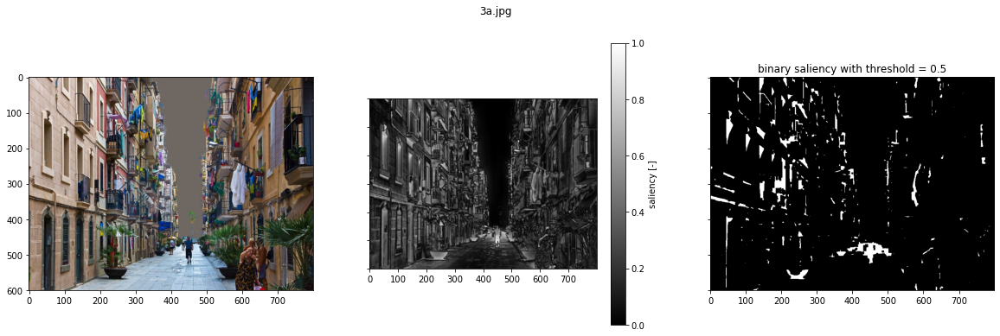

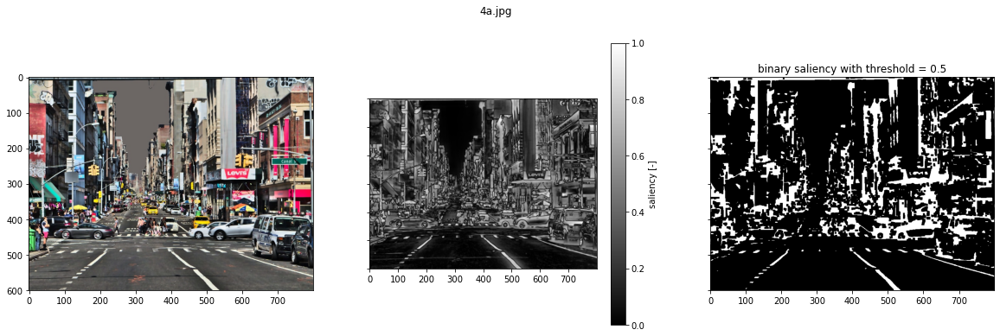

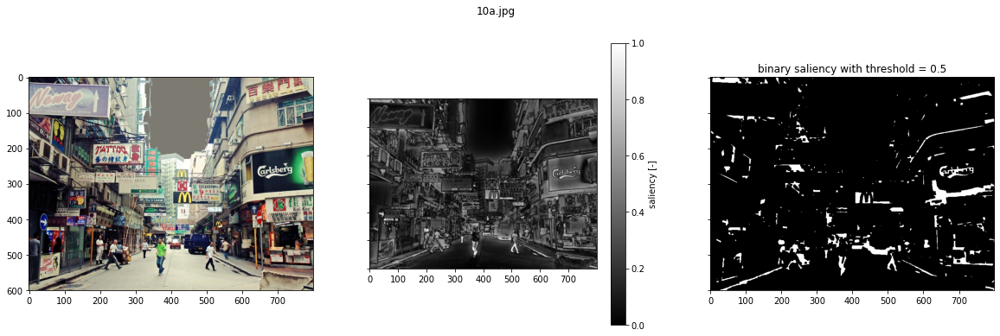

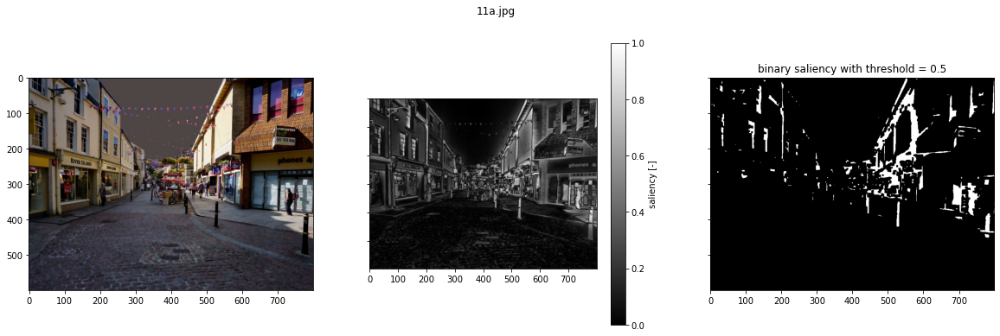

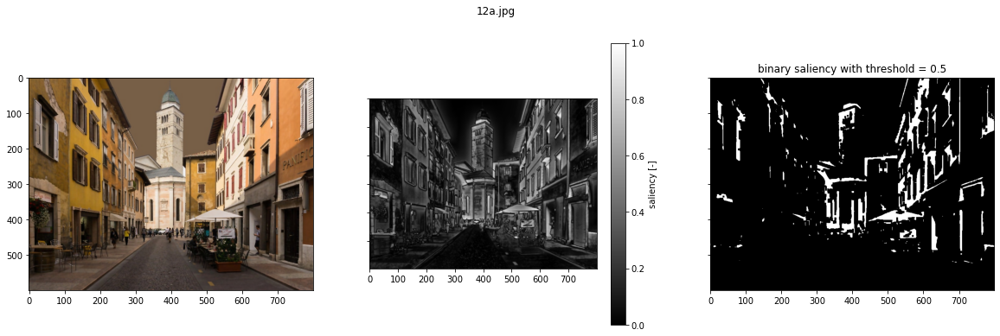

...

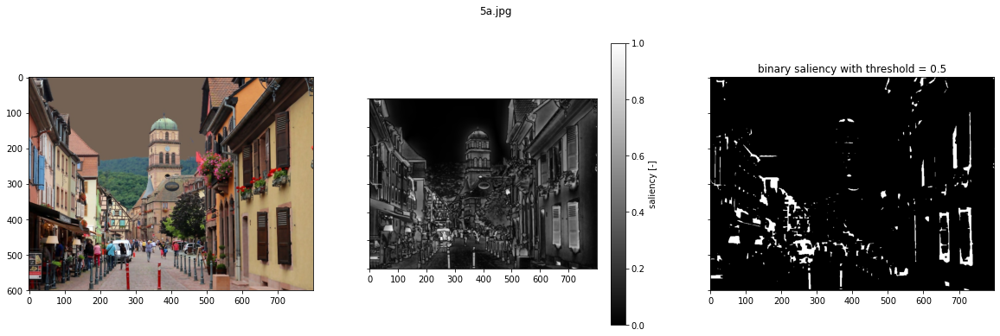

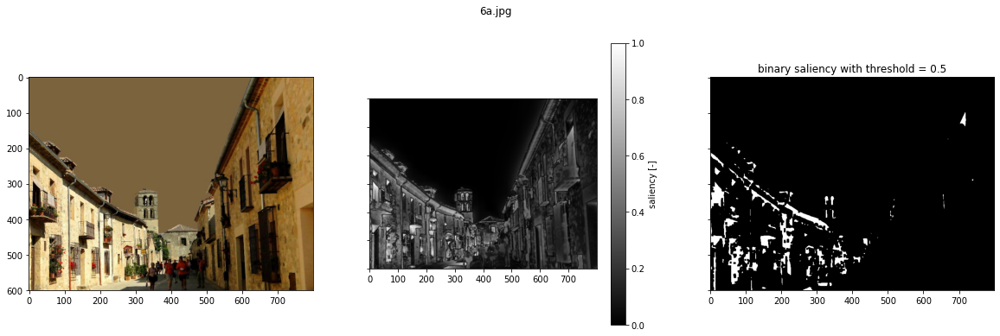

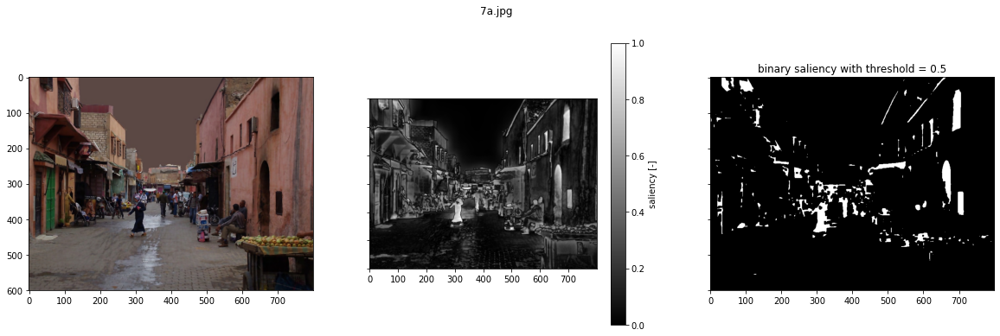

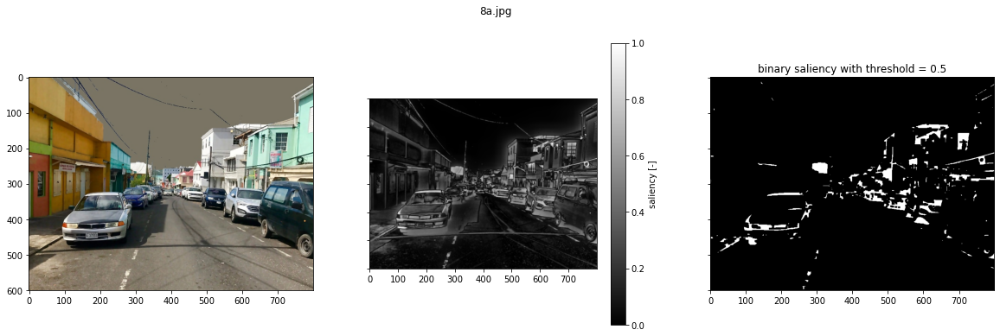

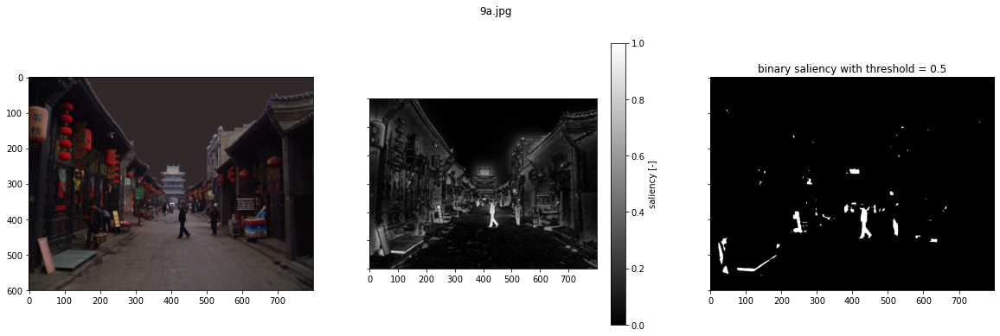

In [6]:
directory=os.path.join(start_directory)
imfiles={}
for filename in os.listdir(directory):
    if filename.endswith('.jpg') or filename.endswith('.jpeg'):
        imfiles[filename]=os.path.join(directory,filename)

salmat={}
threshmap={}
for filename,imfile in imfiles.items():
    image=cv2.imread(imfile,cv2.IMREAD_UNCHANGED)
    
    #rescale factor
    if image.shape[1]>=resampling_width:
        rf=resampling_width/image.shape[1]
    else:
        rf=image.shape[1]/resampling_width
    
    #rescaled image
    image_r=cv2.resize(image,(int(image.shape[1]*rf),int(image.shape[0]*rf)))
    
    #img = mpimg.imread(image_r) # this one is to read the image file instead of the matrix
    
    #image smoothing
    #image_r=cv2.blur(image_r,(30,30))
    image_r=cv2.bilateralFilter(image_r,5,75,75)
    #image_r=cv2.medianBlur(image_r,5)
    #image_r=cv2.GaussianBlur(image_r,(5,5),2)
    
    #saliency computation
    #saliency=cv2.saliency.StaticSaliencySpectralResidual_create() #method 1
    saliency = cv2.saliency.StaticSaliencyFineGrained_create() #method 2
    (success,saliencyMap)= saliency.computeSaliency(image_r)
    salmat[filename]=saliencyMap
    super_thresh=saliencyMap>thresh
    inf_thresh=saliencyMap<=thresh
    
    thresholdMap = saliencyMap.copy()
    thresholdMap[super_thresh]=1
    thresholdMap[inf_thresh]=0
    kernel = np.ones(kersize,np.uint8)
    thresholdMap=cv2.morphologyEx(thresholdMap, cv2.MORPH_CLOSE, kernel)
    
    threshmap[filename]=thresholdMap
    
    fig, (ax1, ax2, ax3) = plt.subplots(1, 3, sharex=True, sharey=True, figsize=(20, 6))
    fig.suptitle(filename)
    ax1.imshow(image_r[:,:,[2,1,0]])
    p=ax2.imshow(saliencyMap, vmin=0, vmax=1, cmap='binary_r')
    fig.colorbar(p, ax=ax2, label='saliency [-]')
    q=ax3.imshow(thresholdMap,vmin=0, vmax=1, cmap='binary_r')
    ax3.set_title('binary saliency with threshold = '+str(thresh))

In [7]:
import os
import pysal
import pandas as pd
from esda.moran import Moran
from libpysal.weights import lat2W

In [8]:
salmat_df=pd.DataFrame(list(salmat.items()),columns=['filename','sal_matrix'])
threshmat_df=pd.DataFrame(list(threshmap.items()),columns=['filename','binary_matrix'])
salmat_df=pd.merge(salmat_df,threshmat_df)
salmat_df

,filename,sal_matrix,binary_matrix
0,3a.jpg,"[[0.0627451, 0.0627451, 0.0627451, 0.0627451, ...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."
1,4a.jpg,"[[0.5176471, 0.5294118, 0.5294118, 0.53333336,...","[[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.0,..."
2,10a.jpg,"[[0.3647059, 0.36078432, 0.3529412, 0.3529412,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0,..."
3,11a.jpg,"[[0.24313727, 0.2509804, 0.25490198, 0.2549019...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."
4,12a.jpg,"[[0.039215688, 0.050980397, 0.07058824, 0.0901...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."
5,13a.jpg,"[[0.20784315, 0.20000002, 0.17254902, 0.105882...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."
6,14a.jpg,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."
7,15a.jpg,"[[0.023529414, 0.023529414, 0.023529414, 0.023...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."
8,16a.jpg,"[[0.24313727, 0.23137257, 0.21568629, 0.192156...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."
9,17a.jpg,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."


In [9]:
counter=0
for index,row in salmat_df.iterrows():
    counter+=1
    w=lat2W(row['sal_matrix'].shape[0],row['sal_matrix'].shape[1])
    v=lat2W(row['binary_matrix'].shape[0],row['binary_matrix'].shape[1])
    
    mi=Moran(row['sal_matrix'],w)
    mii=Moran(row['binary_matrix'],v)
    
    salmat_df.loc[index,'sal_Moran']=mi.I
    salmat_df.loc[index,'binary_Moran']=mii.I
    
    print('\r'+str(round(counter/len(salmat)*100,2))+' % complete',end='')

100.0 % complete

In [10]:
salmat_df

,filename,sal_matrix,binary_matrix,sal_Moran,binary_Moran
0,3a.jpg,"[[0.0627451, 0.0627451, 0.0627451, 0.0627451, ...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...",0.929578,0.849621
1,4a.jpg,"[[0.5176471, 0.5294118, 0.5294118, 0.53333336,...","[[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.0,...",0.924738,0.878546
2,10a.jpg,"[[0.3647059, 0.36078432, 0.3529412, 0.3529412,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0,...",0.927994,0.858487
3,11a.jpg,"[[0.24313727, 0.2509804, 0.25490198, 0.2549019...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...",0.958534,0.885455
4,12a.jpg,"[[0.039215688, 0.050980397, 0.07058824, 0.0901...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...",0.952413,0.886860
5,13a.jpg,"[[0.20784315, 0.20000002, 0.17254902, 0.105882...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...",0.951414,0.865739
6,14a.jpg,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...",0.962239,0.826115
7,15a.jpg,"[[0.023529414, 0.023529414, 0.023529414, 0.023...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...",0.973078,0.910425
8,16a.jpg,"[[0.24313727, 0.23137257, 0.21568629, 0.192156...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...",0.967288,0.921307
9,17a.jpg,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...",0.971338,0.893120


## Export saliency tab

In [12]:
salmat_df.to_excel('Saliency_ranking.xlsx')

## Or... plot ranking

In [61]:
moran=salmat_df.copy()#drop(['binary_matrix','sal_matrix'],axis=1)
ranking=moran.sort_values(by='sal_Moran',axis=0)
ranking_binary=moran.sort_values(by='binary_Moran',axis=0)
ranking['code']=ranking['filename'].map(lambda x:x[0:-4])
ranking['saliency_Moran_rank']=ranking.reset_index().index+1
ranking_binary['binary_Moran_rank']=ranking_binary.reset_index().index+1
ran=ranking.merge(ranking_binary['binary_Moran_rank'],left_index=True,right_index=True)

In [62]:
collectiondata=pd.read_excel(os.path.join(os.path.dirname(directory),'Collection.xlsx'))
ran=ran.merge(collectiondata,left_on='code',right_on='code')
ran

,filename,sal_matrix,binary_matrix,sal_Moran,binary_Moran,code,saliency_Moran_rank,binary_Moran_rank,City,Country,Lat,Lon,rights holder,Link
0,3a.jpg,"[[0.07058824, 0.07058824, 0.07058824, 0.070588...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...",0.922416,0.851942,3a,1,5,Barcelona,Spain,41.379896,2.191075,John Weiss,https://www.flickr.com/photos/jweiss3/39369944...
1,4a.jpg,"[[0.5254902, 0.53333336, 0.5372549, 0.53333336...","[[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.0,...",0.923988,0.878746,4a,2,20,New York,United States,40.719264,-74.002048,hiimlynx,https://www.flickr.com/photos/elizaroff/268875...
2,10a.jpg,"[[0.36078432, 0.3647059, 0.36078432, 0.3607843...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0,...",0.928800,0.860035,10a,3,7,Kowloon,Hong-Kong,22.296482,114.172775,Andrea Schaffer,https://www.flickr.com/photos/aschaf/5678777097/
3,2a.jpg,"[[0.06666667, 0.0627451, 0.0627451, 0.05882353...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...",0.933436,0.831850,2a,4,1,London,England,51.510879,-0.112266,City.and.Color,https://www.flickr.com/photos/52611380@N05/141...
4,27a.jpg,"[[0.13725491, 0.11764707, 0.1137255, 0.1803921...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0,...",0.933742,0.852148,27a,5,6,La Paz,Bolivia,-16.496171,-68.150081,psyberartist,https://www.flickr.com/photos/psyberartist/546...
5,5a.jpg,"[[0.16862746, 0.16470589, 0.14509805, 0.121568...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...",0.946148,0.875575,5a,6,14,Kaysersberg,France,48.138511,7.265894,Joan,https://www.flickr.com/photos/joanbrebo/261105...
6,8a.jpg,"[[0.007843138, 0.007843138, 0.007843138, 0.003...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...",0.947010,0.846205,8a,7,4,St Johns,Antigua,17.121925,-61.842464,- Adam Reeder -,https://www.flickr.com/photos/adamreeder/31809...
7,26a.jpg,"[[0.10196079, 0.10196079, 0.1137255, 0.1137255...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...",0.947468,0.871078,26a,8,9,Barcelona,Spain,41.402674,2.172911,Sander Wapstra,https://www.flickr.com/photos/sanderwapstra/52...
8,20a.jpg,"[[0.1137255, 0.1254902, 0.12941177, 0.13333334...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...",0.949125,0.878558,20a,9,18,Gloucester,England,51.866581,-2.248002,barnyz,https://www.flickr.com/photos/75487768@N04/161...
9,24a.jpg,"[[0.4156863, 0.40784317, 0.40000004, 0.3960784...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...",0.950285,0.841472,24a,10,3,Bacolod City,Philippines,10.663707,122.954134,Brian Evans,https://www.flickr.com/photos/beegee49/2530936...


## Plot based on ranking

In [74]:
ranking_var='sal_Moran'
increasing_complexity=True

In [75]:
sorran=ran.sort_values(by=ranking_var,ascending=not(increasing_complexity))

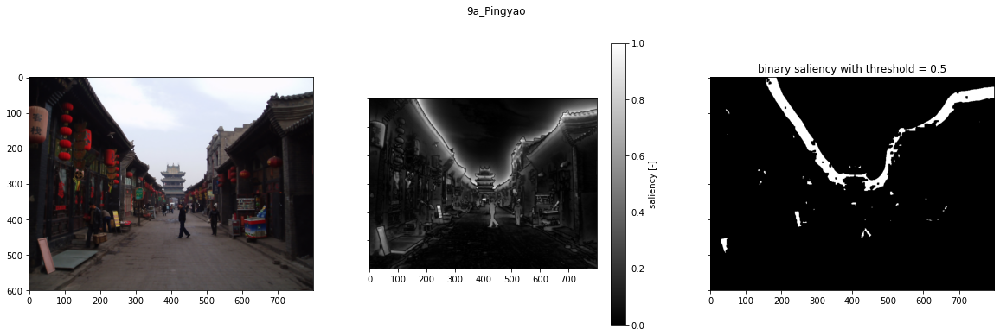

sal_Moran = 0.982


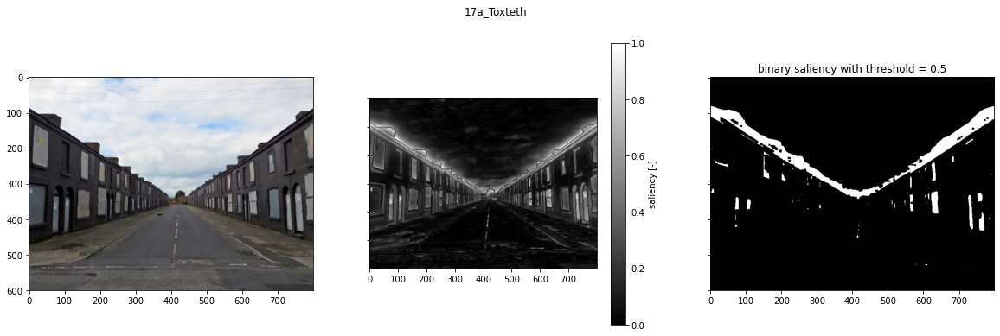

sal_Moran = 0.977


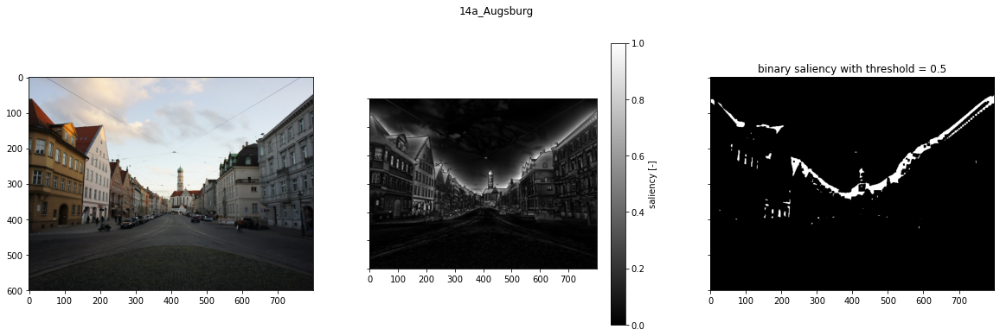

sal_Moran = 0.973


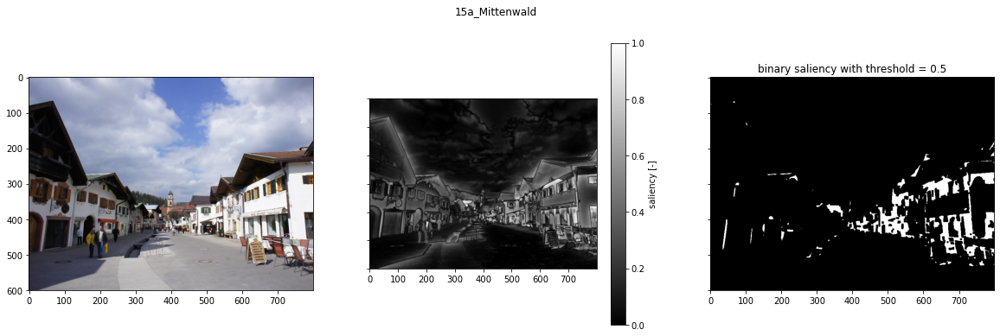

sal_Moran = 0.969


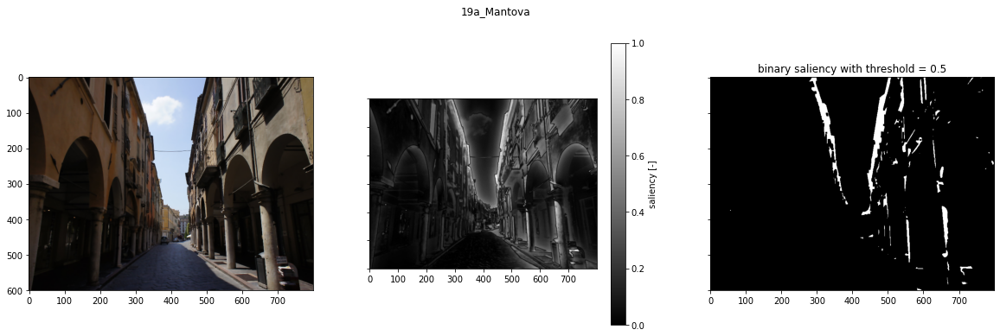

sal_Moran = 0.968


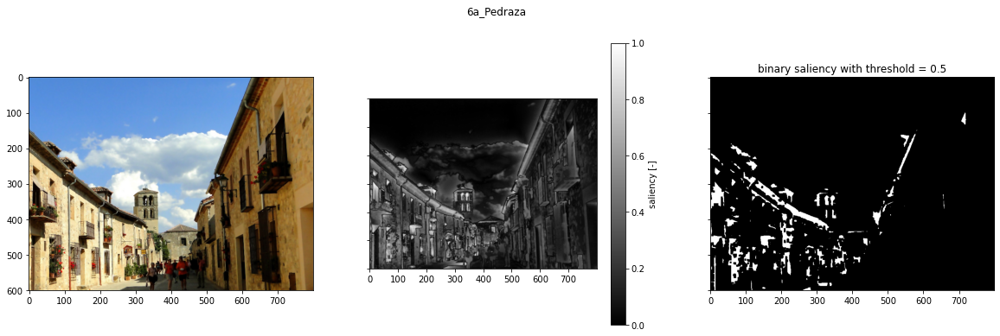

sal_Moran = 0.968


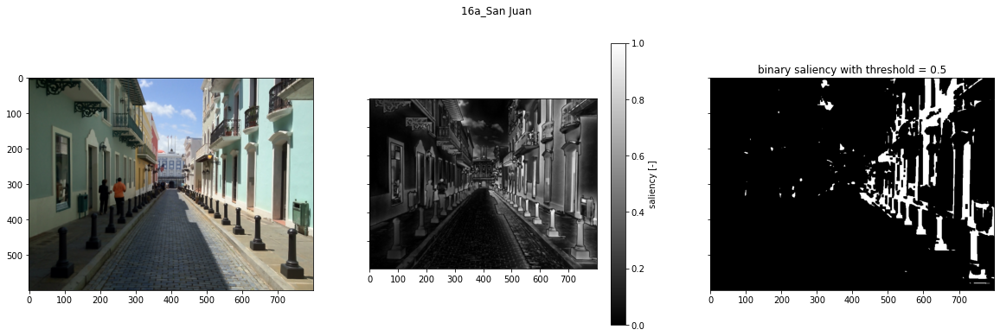

sal_Moran = 0.968


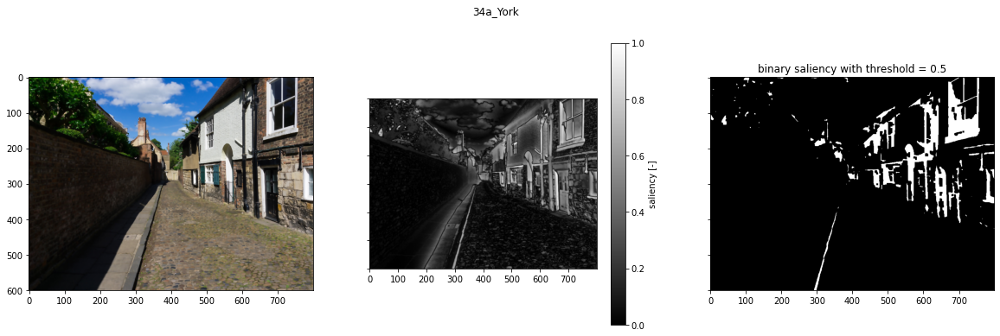

sal_Moran = 0.967


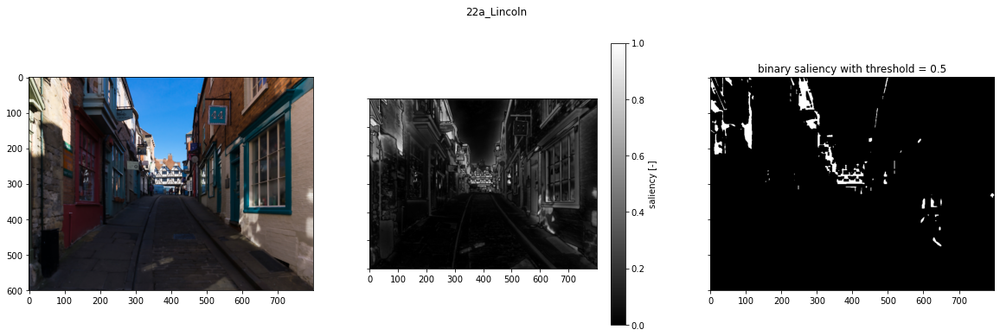

sal_Moran = 0.966


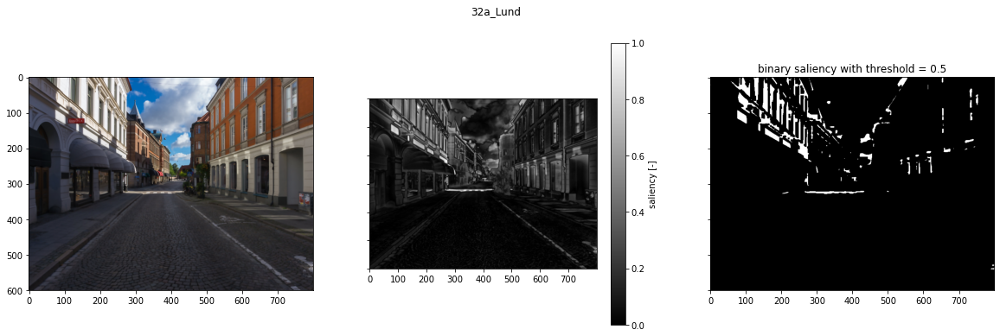

sal_Moran = 0.965


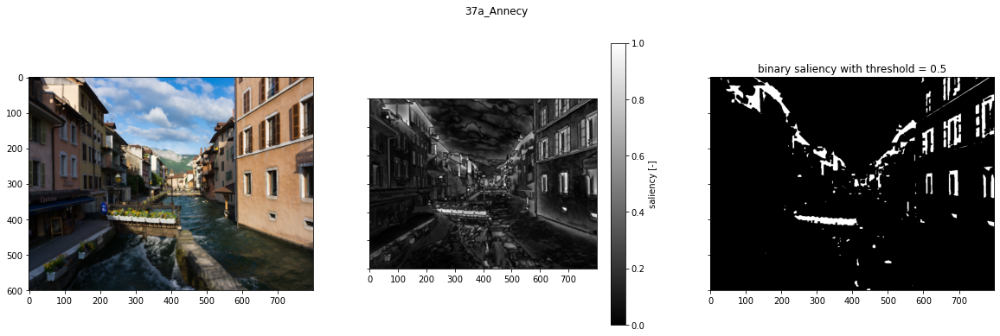

sal_Moran = 0.964


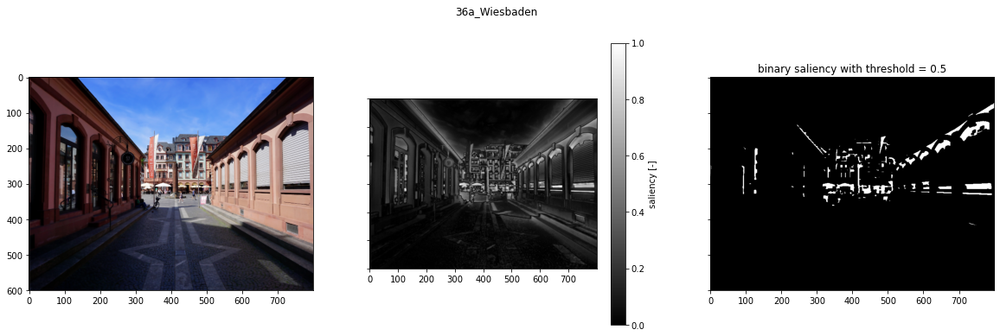

sal_Moran = 0.964


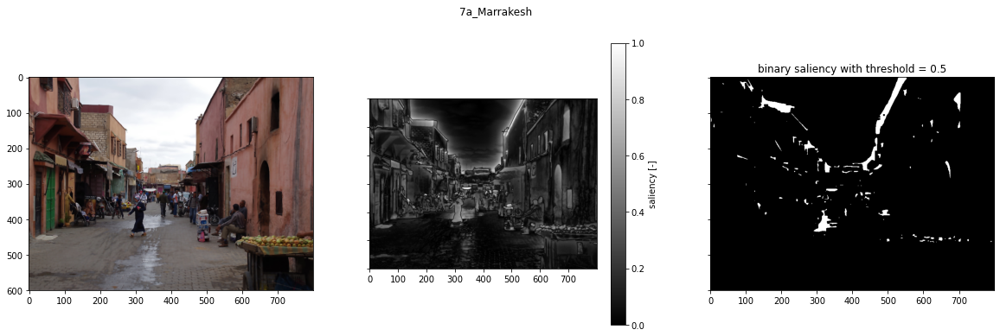

sal_Moran = 0.963


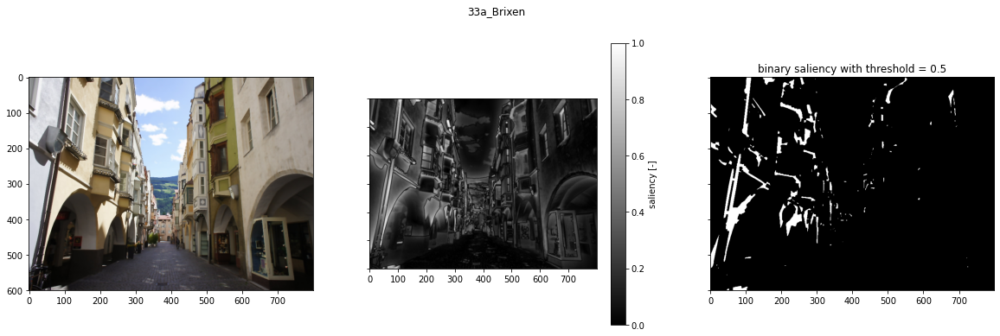

sal_Moran = 0.963


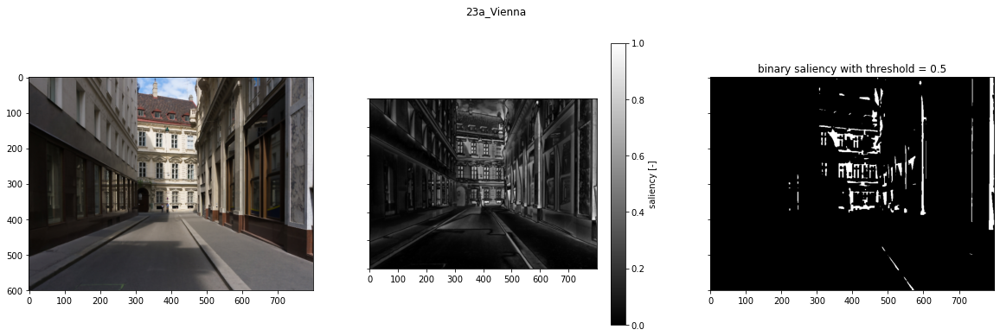

sal_Moran = 0.962


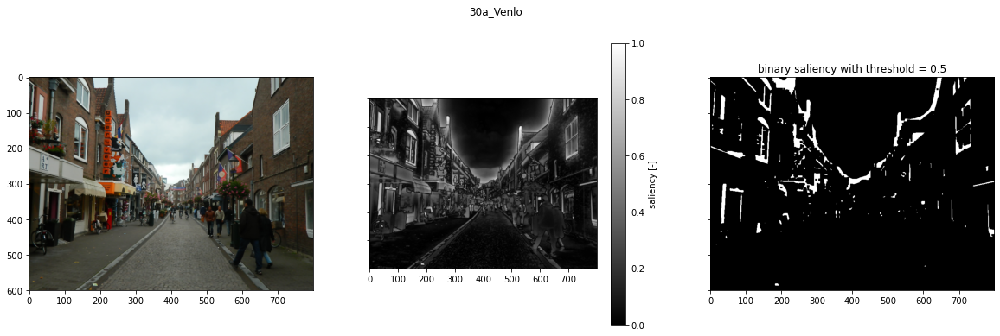

sal_Moran = 0.961


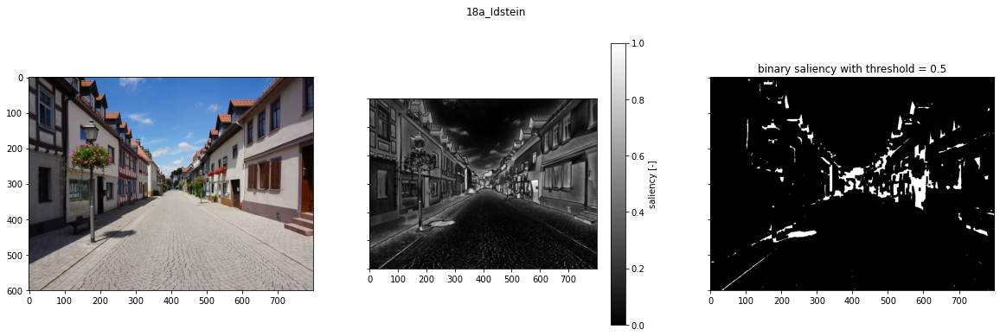

sal_Moran = 0.96


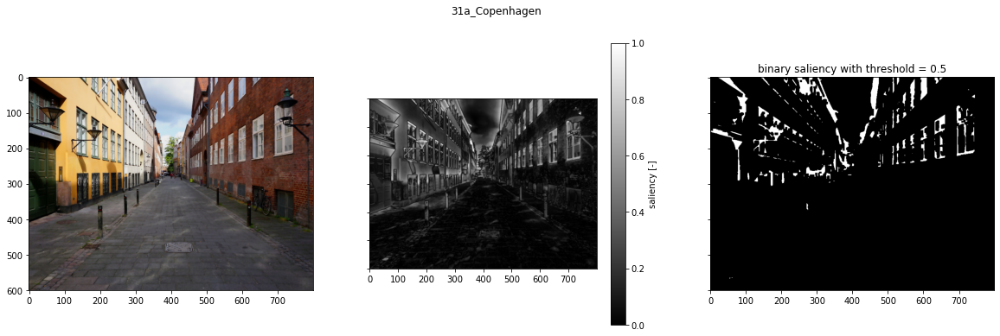

sal_Moran = 0.96


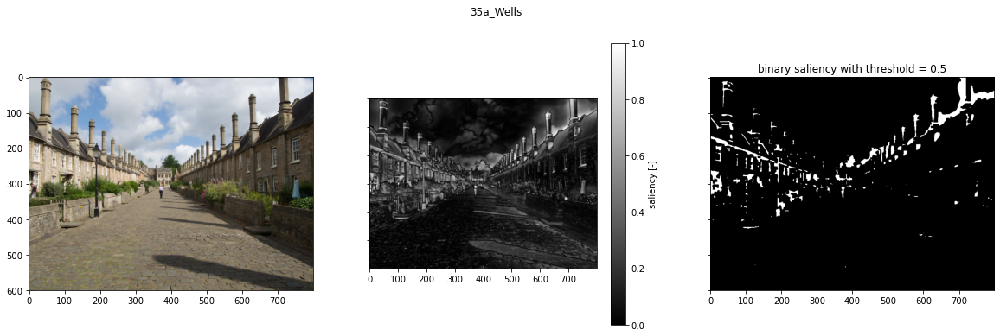

sal_Moran = 0.96


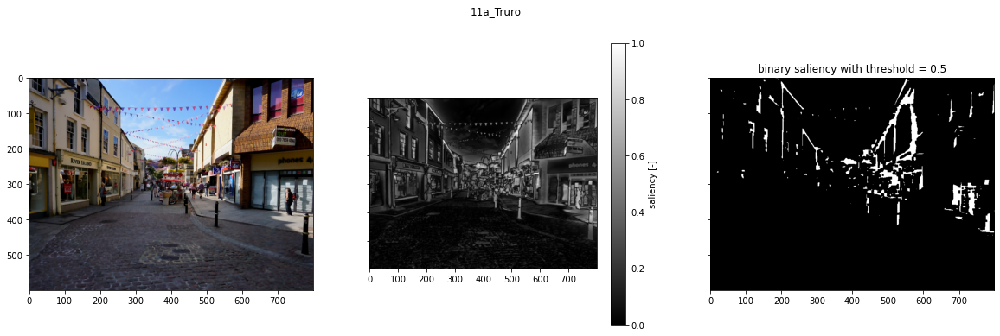

sal_Moran = 0.959


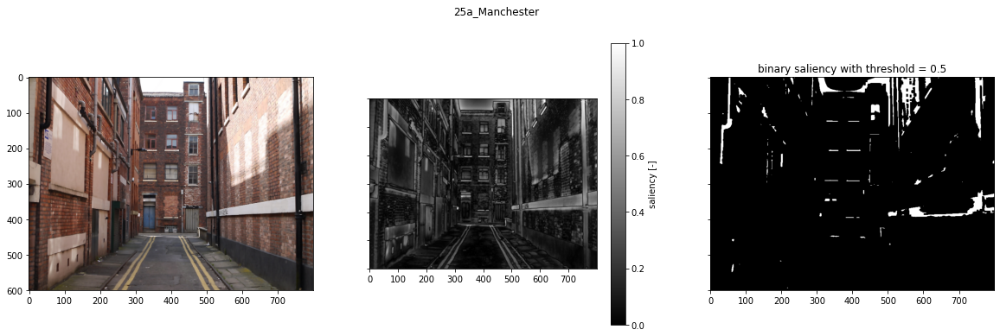

sal_Moran = 0.958


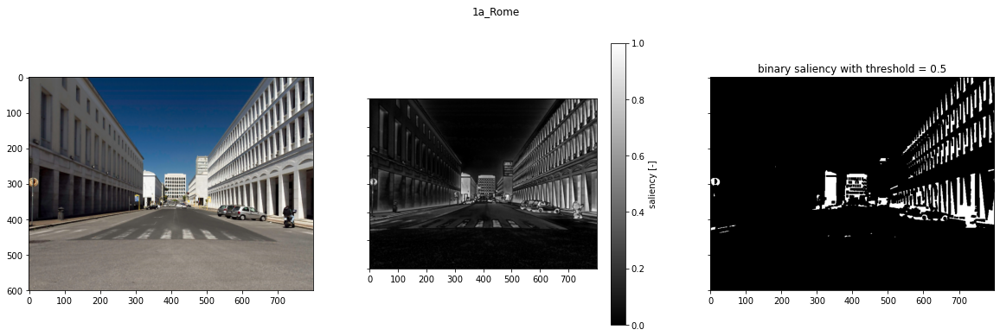

sal_Moran = 0.957


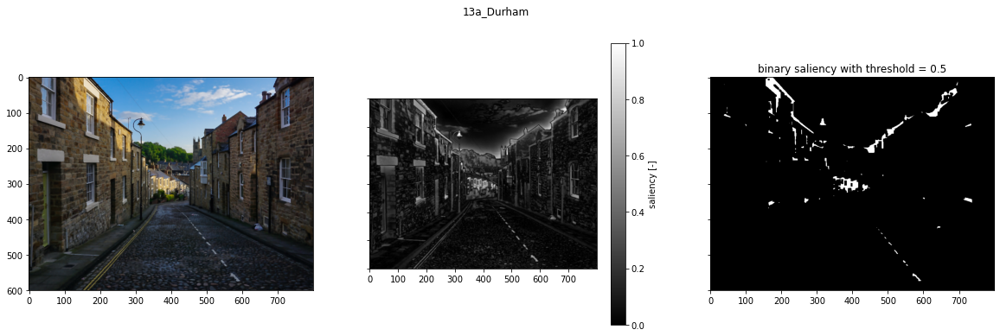

sal_Moran = 0.955


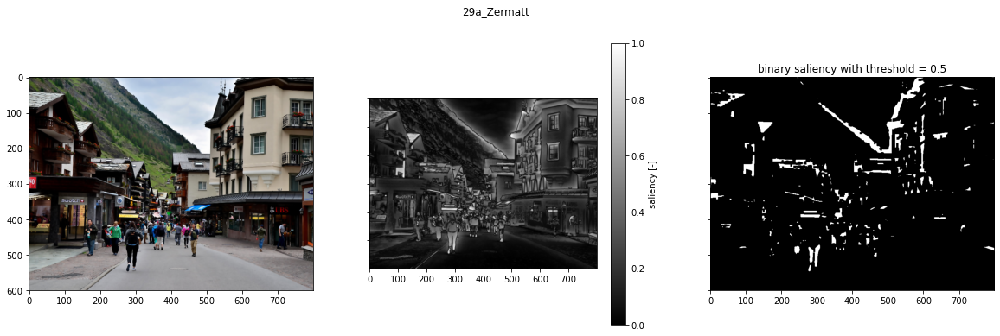

sal_Moran = 0.954


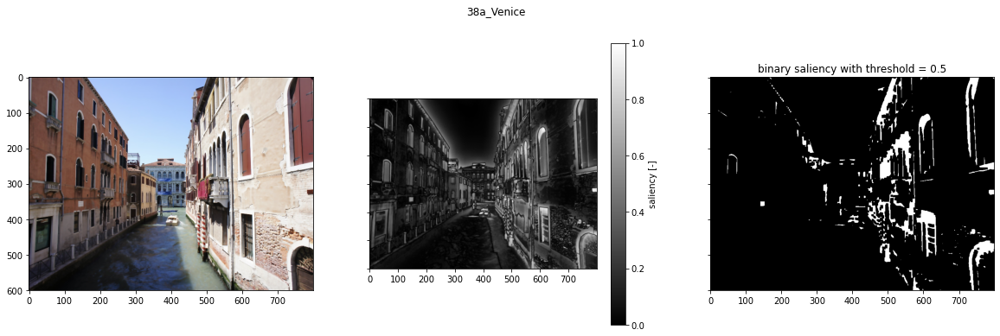

sal_Moran = 0.953


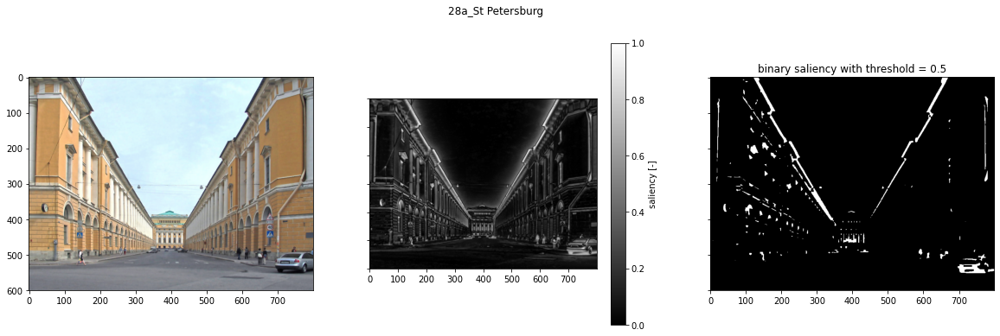

sal_Moran = 0.952


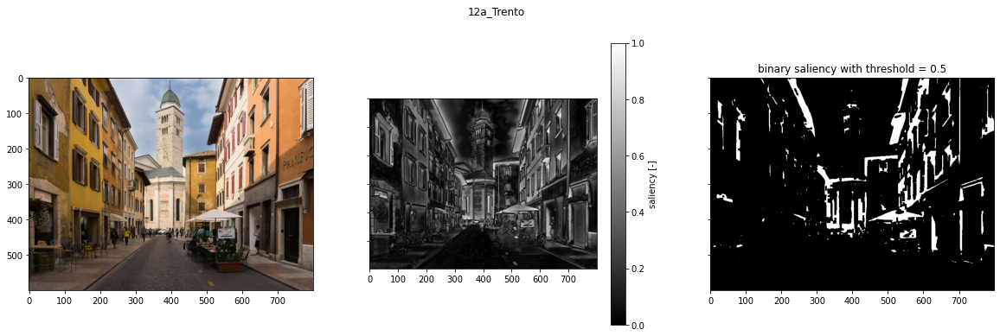

sal_Moran = 0.952


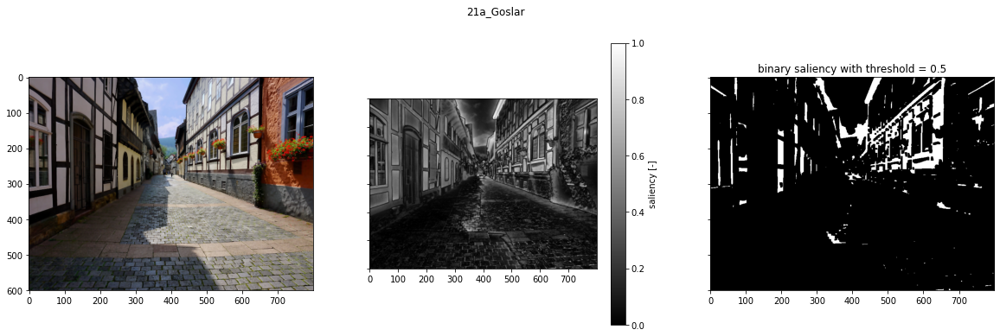

sal_Moran = 0.951


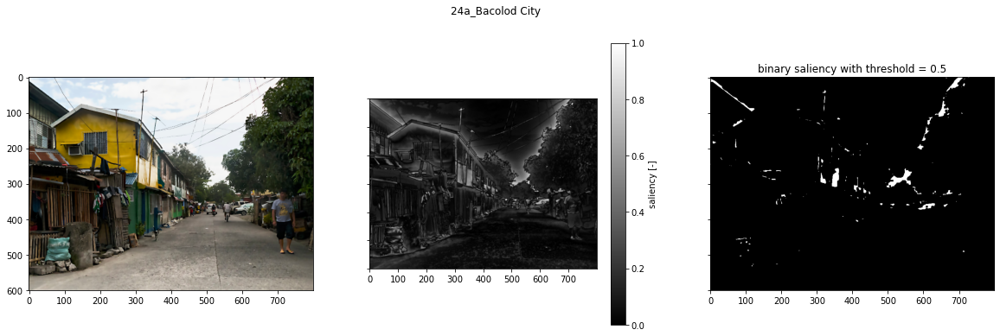

sal_Moran = 0.95


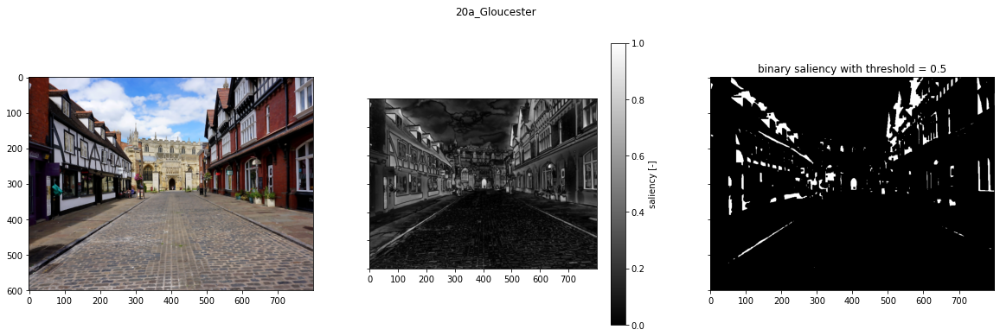

sal_Moran = 0.949


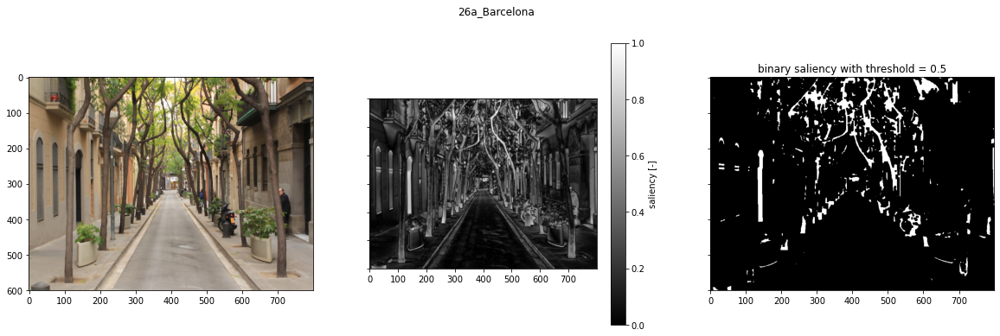

sal_Moran = 0.947


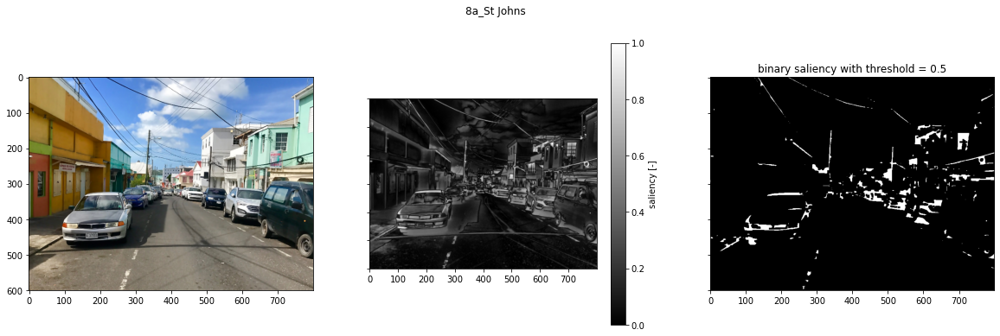

sal_Moran = 0.947


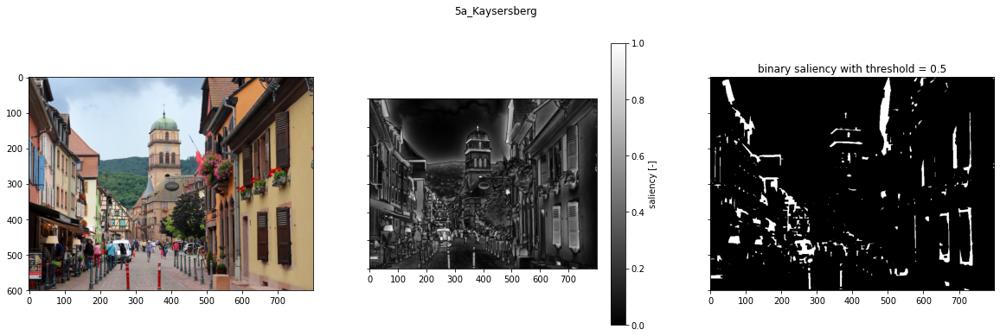

sal_Moran = 0.946


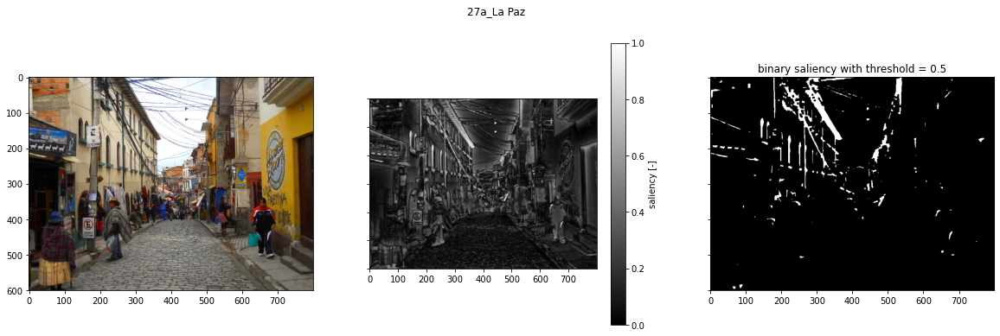

sal_Moran = 0.934


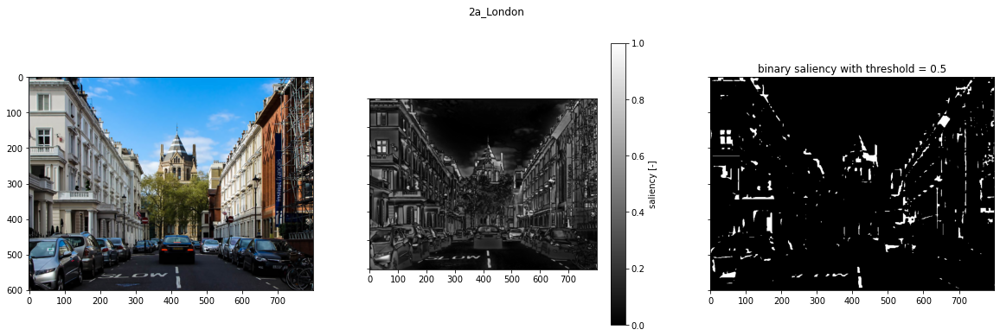

sal_Moran = 0.933


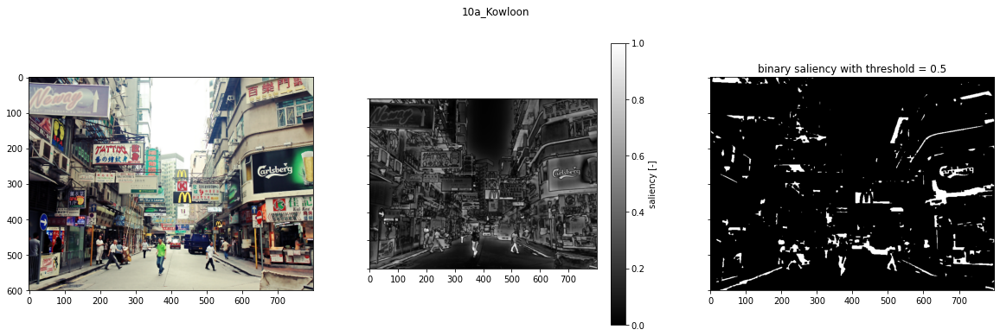

sal_Moran = 0.929


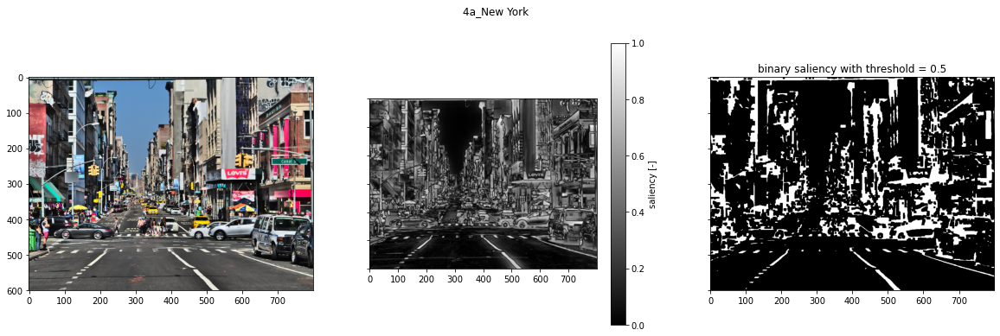

sal_Moran = 0.924


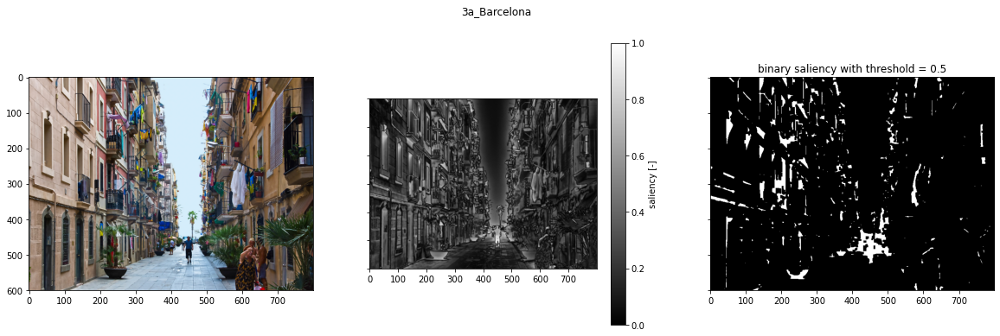

sal_Moran = 0.922


In [76]:
for index,row in sorran.iterrows():
    picfile=os.path.join(directory,row['filename'])
    pic=cv2.imread(picfile,cv2.IMREAD_UNCHANGED)
    #rescale factor
    if pic.shape[1]>=resampling_width:
        rf=resampling_width/pic.shape[1]
    else:
        rf=pic.shape[1]/resampling_width
    pic_r=cv2.resize(pic,(int(pic.shape[1]*rf),int(pic.shape[0]*rf)))
    pic_r=cv2.bilateralFilter(pic_r,5,75,75) #filter like above
    #plot
    fig, (ax1, ax2, ax3) = plt.subplots(1, 3, sharex=True, sharey=True, figsize=(20, 6))
    fig.suptitle(row['code']+'_'+row['City'])
    ax1.imshow(pic_r[:,:,[2,1,0]])
    p=ax2.imshow(row['sal_matrix'], vmin=0, vmax=1, cmap='binary_r')
    fig.colorbar(p, ax=ax2, label='saliency [-]')
    q=ax3.imshow(row['binary_matrix'],vmin=0, vmax=1, cmap='binary_r')
    ax3.set_title('binary saliency with threshold = '+str(thresh))
    plt.show()
    #dataframe
    print(ranking_var+' = '+str(round(row[ranking_var],3)))

In [ ]:
exc=pd.read_excel(r'E:\GDrive\EPFL\_RESEARCH\CRENAU\Photos\Saliency\Collection\Collection.xlsx')
pd.merge(exc,ranking,left_on='code',right_on='code').to_excel(r'E:\GDrive\EPFL\_RESEARCH\CRENAU\Photos\Saliency\Collection\Saliency_ranking.xlsx','Saliency_rank')

there is not much variability among the 3 unfortunately, but the ranking is correct, i.e. WhereisWaldo is the most complex, followed by Central Park and Via Po

## from Matlab's Saliency Toolbox

In [ ]:
file=os.path.join(os.path.dirname(os.getcwd()),'Photos','Saliency','saliency_matrices.xlsx')

In [ ]:
excel={
'via_po':pd.read_excel(file,sheet_name=0,header=None),
'cp_nyc':pd.read_excel(file,sheet_name=1,header=None),
'waldo':pd.read_excel(file,sheet_name=2,header=None)
}

In [ ]:
from esda.moran import Moran
from libpysal.weights import lat2W
moran_results={}
for key,value in excel.items():
    w=lat2W(value.shape[0],value.shape[1])
    mi=Moran(value,w)
    moran_results[key]=(mi.I)

In [ ]:
moran_results_df=pd.DataFrame(list(moran_results.items()),columns=['name','Moran'])
moran_results_df.sort_values(by='Moran',axis=0)

here there is more variability at list with WhereisWaldo, and the ranking is also as expected.